In [1]:
pip install fiona geopandas xgboost gensim folium pyLDAvis descartes

Note: you may need to restart the kernel to use updated packages.


In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd

from shapely.geometry import Point

%matplotlib inline

In [2]:
# Read in state geometry file
state_df = gpd.read_file("https://datascience.quantecon.org/assets/data/cb_2016_us_state_5m.zip")
state_df.head()

,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER,geometry
0,01,01779775,0400000US01,01,AL,Alabama,00,131173688951,4593686489,"MULTIPOLYGON (((-88.04374 30.51742, -88.03661 ..."
1,02,01785533,0400000US02,02,AK,Alaska,00,1477946266785,245390495931,"MULTIPOLYGON (((-133.65582 55.62562, -133.6249..."
2,04,01779777,0400000US04,04,AZ,Arizona,00,294198560125,1027346486,"POLYGON ((-114.79968 32.59362, -114.80939 32.6..."
3,08,01779779,0400000US08,08,CO,Colorado,00,268429343790,1175112870,"POLYGON ((-109.06025 38.59933, -109.05954 38.7..."
4,09,01779780,0400000US09,09,CT,Connecticut,00,12542638347,1815476291,"POLYGON ((-73.72777 41.10070, -73.69595 41.115..."


In [3]:
print(state_df.columns)

Index(['STATEFP', 'STATENS', 'AFFGEOID', 'GEOID', 'STUSPS', 'NAME', 'LSAD',
       'ALAND', 'AWATER', 'geometry'],
      dtype='object')


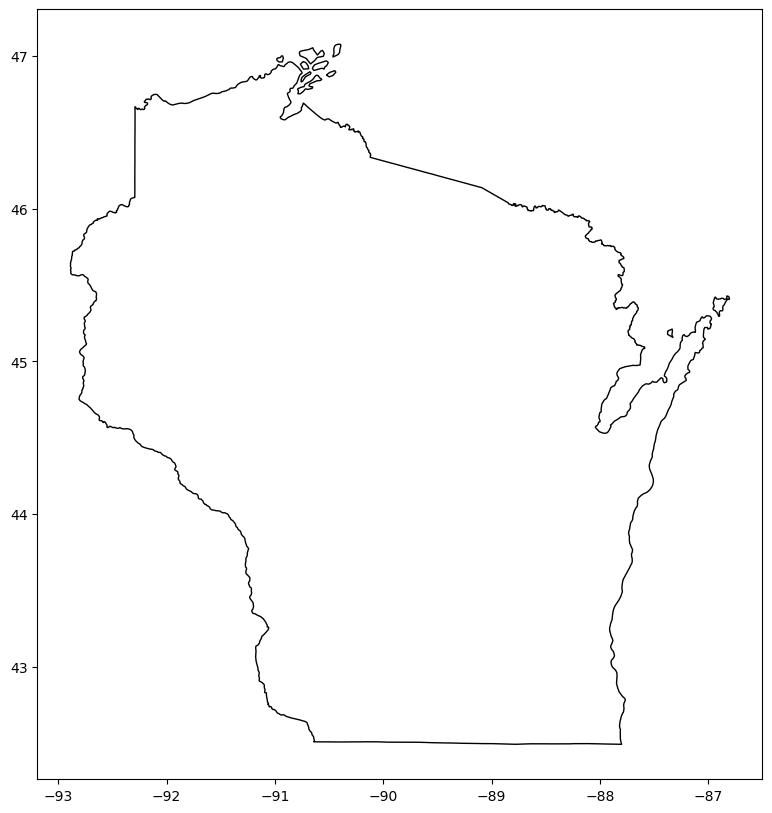

In [4]:
# Apply geometry for state of interest
fig, gax = plt.subplots(figsize=(10, 10))
state_df.query("NAME == 'Wisconsin'").plot(ax=gax, edgecolor="black", color="white")
plt.show()

In [5]:
# Read in Census Tract geometries as a zip TIGER file
# This can be found from the Census TIGER file database with specifications of "Wisconsin", "Census Tract", and "2010" to match RUCA codes
tract_df = gpd.read_file("tl_2010_55_tract10.zip")
tract_df.head()

,STATEFP10,COUNTYFP10,TRACTCE10,GEOID10,NAME10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,geometry
0,55,037,190100,55037190100,1901,Census Tract 1901,G5020,S,533148604,12521848,+45.9196317,-088.3668177,"POLYGON ((-88.33932 45.88593, -88.33936 45.885..."
1,55,037,190200,55037190200,1902,Census Tract 1902,G5020,S,731271311,11638370,+45.7916417,-088.4102346,"POLYGON ((-88.15661 45.71680, -88.16196 45.717..."
2,55,019,950300,55019950300,9503,Census Tract 9503,G5020,S,291980758,1100443,+44.9685240,-090.7894199,"POLYGON ((-90.64165 44.94509, -90.64167 44.944..."
3,55,019,950700,55019950700,9507,Census Tract 9507,G5020,S,104152996,1410738,+44.6203635,-090.6036756,"POLYGON ((-90.65073 44.56215, -90.65123 44.562..."
4,55,019,950600,55019950600,9506,Census Tract 9506,G5020,S,548466603,2371150,+44.5621159,-090.4268660,"POLYGON ((-90.33647 44.68505, -90.33634 44.685..."


In [6]:
print(tract_df.columns)

Index(['STATEFP10', 'COUNTYFP10', 'TRACTCE10', 'GEOID10', 'NAME10',
       'NAMELSAD10', 'MTFCC10', 'FUNCSTAT10', 'ALAND10', 'AWATER10',
       'INTPTLAT10', 'INTPTLON10', 'geometry'],
      dtype='object')


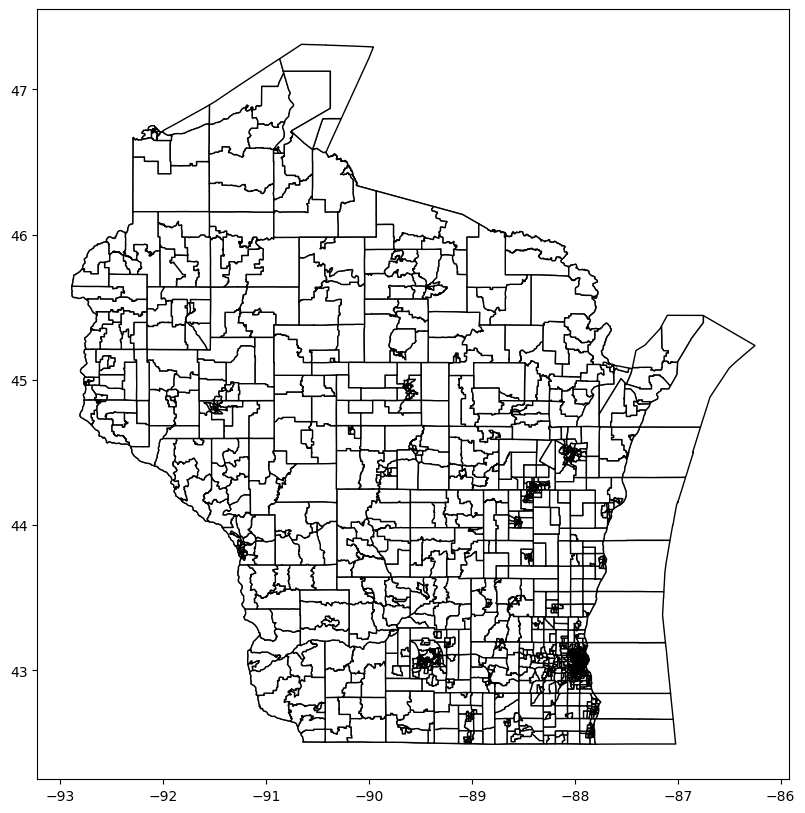

In [7]:
# Apply state geometry to tract geometries
fig, gax = plt.subplots(figsize=(10, 10))

state_df.query("NAME == 'Wisconsin'").plot(ax=gax, edgecolor="black", color="white")
tract_df.plot(ax=gax, edgecolor="black", color="white")

plt.show()

In [8]:
# Read in RUCA file from USDA specifications
ruca = pd.read_csv("RUCA-Definitions.csv", thousands=",")
ruca.head()

,State-County FIPS Code,Select State,Select County,Total-FIPS-Code,Primary RUCA Code 2010,"Secondary RUCA Code, 2010 (see errata)","Tract Population, 2010","Land Area (square miles), 2010","Population Density (per square mile), 2010",Urban-or-Rural-USDA-Classification
0,55001,WI,Adams County,55001950201,10,10.0,1379,42.5,32.4,Rural
1,55001,WI,Adams County,55001950202,10,10.0,2674,180.6,14.8,Rural
2,55001,WI,Adams County,55001950400,10,10.0,4767,91.0,52.4,Rural
3,55001,WI,Adams County,55001950501,10,10.0,1469,44.1,33.3,Rural
4,55001,WI,Adams County,55001950502,10,10.0,4112,96.3,42.7,Rural


In [9]:
# For ruca DataFrame
if ruca["Total-FIPS-Code"].dtype == 'object':  # Check if the column contains string values
    ruca["Total-FIPS-Code"] = ruca["Total-FIPS-Code"].str.title()
    ruca["Total-FIPS-Code"] = ruca["Total-FIPS-Code"].str.strip()

# For tract_df DataFrame
if tract_df["GEOID10"].dtype == 'object':  # Check if the column contains string values
    tract_df["GEOID10"] = tract_df["GEOID10"].str.title()
    tract_df["GEOID10"] = tract_df["GEOID10"].str.strip()

In [10]:
# Merge data from RUCA codes and Tract geometries
tract_df['GEOID10'] = tract_df['GEOID10'].astype('int64')

res_w_tracts = tract_df.merge(ruca, left_on="GEOID10", right_on="Total-FIPS-Code", how="inner")

res_w_tracts

,STATEFP10,COUNTYFP10,TRACTCE10,GEOID10,NAME10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,...,State-County FIPS Code,Select State,Select County,Total-FIPS-Code,Primary RUCA Code 2010,"Secondary RUCA Code, 2010 (see errata)","Tract Population, 2010","Land Area (square miles), 2010","Population Density (per square mile), 2010",Urban-or-Rural-USDA-Classification
0,55,037,190100,55037190100,1901,Census Tract 1901,G5020,S,533148604,12521848,...,55037,WI,Florence County,55037190100,5,5.0,2603,205.8,12.6,Urban
1,55,037,190200,55037190200,1902,Census Tract 1902,G5020,S,731271311,11638370,...,55037,WI,Florence County,55037190200,5,5.0,1820,282.3,6.4,Urban
2,55,019,950300,55019950300,9503,Census Tract 9503,G5020,S,291980758,1100443,...,55019,WI,Clark County,55019950300,10,10.0,4350,112.7,38.6,Rural
3,55,019,950700,55019950700,9507,Census Tract 9507,G5020,S,104152996,1410738,...,55019,WI,Clark County,55019950700,10,10.0,3635,40.2,90.4,Rural
4,55,019,950600,55019950600,9506,Census Tract 9506,G5020,S,548466603,2371150,...,55019,WI,Clark County,55019950600,10,10.0,4797,211.8,22.7,Rural
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1389,55,087,010602,55087010602,106.02,Census Tract 106.02,G5020,S,2586335,0,...,55087,WI,Outagamie County,55087010602,1,1.0,3971,1.0,3976.6,Urban
1390,55,087,010601,55087010601,106.01,Census Tract 106.01,G5020,S,2835853,348422,...,55087,WI,Outagamie County,55087010601,1,1.0,3629,1.1,3314.4,Urban
1391,55,087,010500,55087010500,105,Census Tract 105,G5020,S,2277390,244463,...,55087,WI,Outagamie County,55087010500,1,1.0,4451,0.9,5062.0,Urban
1392,55,087,013300,55087013300,133,Census Tract 133,G5020,S,103572426,2342406,...,55087,WI,Outagamie County,55087013300,1,1.0,6551,40.0,163.8,Urban


In [11]:
print(res_w_tracts.columns)

Index(['STATEFP10', 'COUNTYFP10', 'TRACTCE10', 'GEOID10', 'NAME10',
       'NAMELSAD10', 'MTFCC10', 'FUNCSTAT10', 'ALAND10', 'AWATER10',
       'INTPTLAT10', 'INTPTLON10', 'geometry', 'State-County FIPS Code',
       'Select State', 'Select County', 'Total-FIPS-Code',
       'Primary RUCA Code 2010', 'Secondary RUCA Code, 2010 (see errata)',
       'Tract Population, 2010', 'Land Area (square miles), 2010',
       'Population Density (per square mile), 2010',
       'Urban-or-Rural-USDA-Classification'],
      dtype='object')


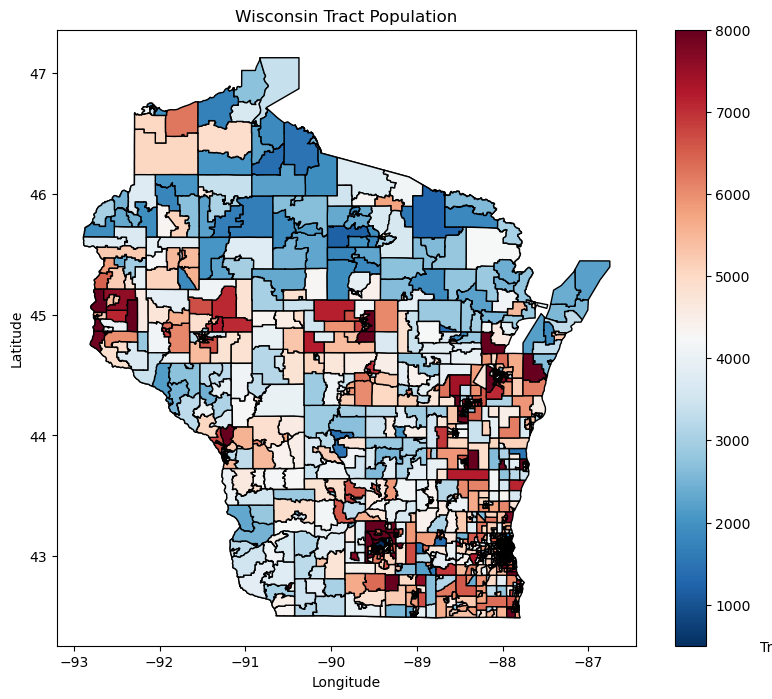

In [12]:
# Use subplots to apply merged information to the state and tract geometries
fig, gax = plt.subplots(figsize = (10,8))

# Plot the state
state_df[state_df['NAME'] == 'Wisconsin'].plot(ax = gax, edgecolor='black',color='white')

res_w_tracts.plot(
    ax=gax, edgecolor='black', column='Tract Population, 2010', legend=True, cmap='RdBu_r',
    vmin=500, vmax=8000)

# Add text 
gax.annotate('Tract Population',xy=(0.76, 0.06),  xycoords='figure fraction')

# I want the axis with long and lat but not necessary
#plt.axis('off')

plt.title('Wisconsin Tract Population')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.savefig('WI-Tract-Population.png')

plt.show()

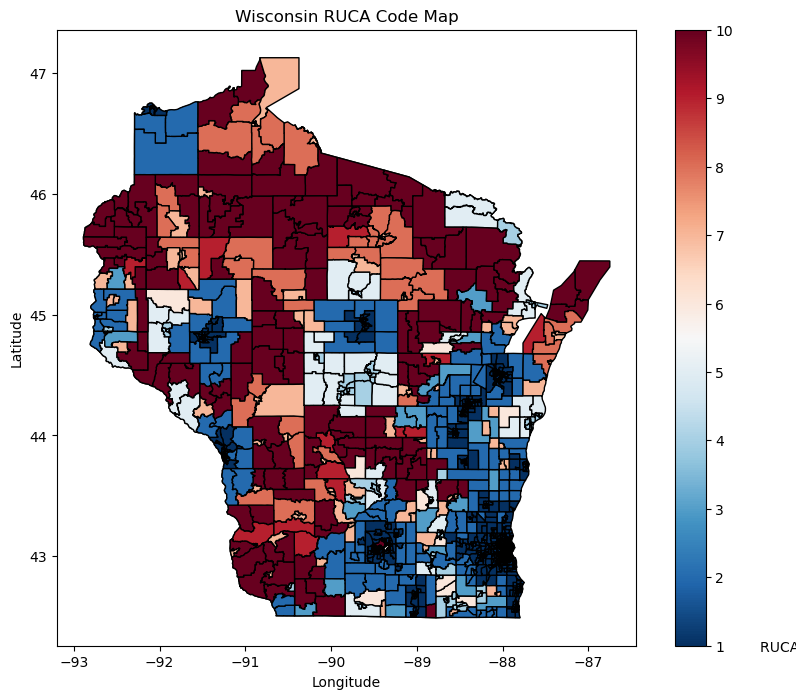

In [13]:
# Use subplots to apply merged information to the state and tract geometries
fig, gax = plt.subplots(figsize = (10,8))

# Plot the state
state_df[state_df['NAME'] == 'Wisconsin'].plot(ax = gax, edgecolor='black',color='white')

res_w_tracts.plot(
    ax=gax, edgecolor='black', column='Primary RUCA Code 2010', legend=True, cmap='RdBu_r',
    vmin=1, vmax=10)

# Add text 
gax.annotate('RUCA Classification',xy=(0.76, 0.06),  xycoords='figure fraction')

# I want the axis with long and lat but not necessary
#plt.axis('off')

plt.title('Wisconsin RUCA Code Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.savefig('WI-RUCA-Map.png')

plt.show()

In [14]:
# Add a new column based on conditions
res_w_tracts['Numerical-Classification'] = res_w_tracts['Urban-or-Rural-USDA-Classification'].apply(lambda x: 1 if x == 'Urban' else (2 if x == 'Rural' else None))

res_w_tracts

,STATEFP10,COUNTYFP10,TRACTCE10,GEOID10,NAME10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,...,Select State,Select County,Total-FIPS-Code,Primary RUCA Code 2010,"Secondary RUCA Code, 2010 (see errata)","Tract Population, 2010","Land Area (square miles), 2010","Population Density (per square mile), 2010",Urban-or-Rural-USDA-Classification,Numerical-Classification
0,55,037,190100,55037190100,1901,Census Tract 1901,G5020,S,533148604,12521848,...,WI,Florence County,55037190100,5,5.0,2603,205.8,12.6,Urban,1
1,55,037,190200,55037190200,1902,Census Tract 1902,G5020,S,731271311,11638370,...,WI,Florence County,55037190200,5,5.0,1820,282.3,6.4,Urban,1
2,55,019,950300,55019950300,9503,Census Tract 9503,G5020,S,291980758,1100443,...,WI,Clark County,55019950300,10,10.0,4350,112.7,38.6,Rural,2
3,55,019,950700,55019950700,9507,Census Tract 9507,G5020,S,104152996,1410738,...,WI,Clark County,55019950700,10,10.0,3635,40.2,90.4,Rural,2
4,55,019,950600,55019950600,9506,Census Tract 9506,G5020,S,548466603,2371150,...,WI,Clark County,55019950600,10,10.0,4797,211.8,22.7,Rural,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1389,55,087,010602,55087010602,106.02,Census Tract 106.02,G5020,S,2586335,0,...,WI,Outagamie County,55087010602,1,1.0,3971,1.0,3976.6,Urban,1
1390,55,087,010601,55087010601,106.01,Census Tract 106.01,G5020,S,2835853,348422,...,WI,Outagamie County,55087010601,1,1.0,3629,1.1,3314.4,Urban,1
1391,55,087,010500,55087010500,105,Census Tract 105,G5020,S,2277390,244463,...,WI,Outagamie County,55087010500,1,1.0,4451,0.9,5062.0,Urban,1
1392,55,087,013300,55087013300,133,Census Tract 133,G5020,S,103572426,2342406,...,WI,Outagamie County,55087013300,1,1.0,6551,40.0,163.8,Urban,1


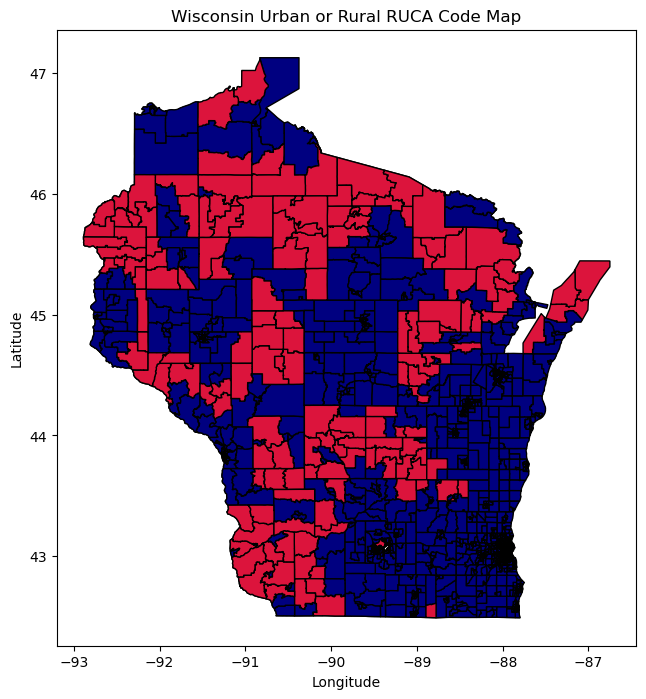

In [15]:
# Use subplots to apply merged information to the state and tract geometries
fig, gax = plt.subplots(figsize = (10,8))

# Plot the state
state_df[state_df['NAME'] == 'Wisconsin'].plot(ax = gax, edgecolor='black', color='white')

res_w_tracts[res_w_tracts['Urban-or-Rural-USDA-Classification'] == 'Urban'].plot(ax=gax, edgecolor='black', color='navy')
res_w_tracts[res_w_tracts['Urban-or-Rural-USDA-Classification'] == 'Rural'].plot(ax=gax, edgecolor='black', color='crimson')

# I want the axis with long and lat but not necessary
#plt.axis('off')

plt.title('Wisconsin Urban or Rural RUCA Code Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.savefig('Simplified-WI-RUCA-Map.png')

plt.show()

In [16]:
from bokeh.io import output_notebook
from bokeh.plotting import figure, ColumnDataSource
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar, HoverTool
from bokeh.palettes import brewer
output_notebook()
import json
#Convert data to geojson for bokeh
wi_geojson=GeoJSONDataSource(geojson=res_w_tracts.to_json())

Loading BokehJS ...

In [20]:
# Use Bokeh software to use hovertools over different tracts
color_mapper = LinearColorMapper(palette = brewer['PRGn'][10], low = 1, high = 10)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color='black',location = (0,0), orientation = 'horizontal')
hover = HoverTool(tooltips = [('Total FIPS Code','@GEOID10'),('Census Tract','@NAMELSAD10'),])
p = figure(title="Wisconsin RUCA Map", tools=[hover])
p.patches("xs","ys",source=wi_geojson,
          fill_color = {'field' :'Primary RUCA Code 2010', 'transform' : color_mapper})
p.add_layout(color_bar, 'below')
p.add_tools('reset')
p.add_tools('wheel_zoom')
p.add_tools('zoom_in')
p.add_tools('zoom_out')
p.add_tools('box_select')
p.add_tools('save')
p.add_tools('pan')

show(p)

In [18]:
from bokeh.plotting import figure, output_file, save

# set output to static HTML file
output_file(filename="RUCA-Hover_Map.html", title="RUCA HTML file")

# create a new plot with a specific size
p = figure(sizing_mode="stretch_width", max_width=500, height=250)

# save the results to a file
save(p)

'/Users/irelandrosegorecki/Desktop/RUCA-Hover_Map.html'